# Step 1: Understand the Dataset

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import LabelEncoder

import scipy.stats as stats
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectKBest
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import GridSearchCV

C:\Users\devan\AppData\Local\Temp\ipykernel_37760\4182436769.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
data = pd.read_csv("C:\\Users\\devan\\OneDrive\\Desktop\\MCA\\datasets\\Asteroids Classification\\nasa.csv")

In [3]:
data

,Neo Reference ID,Name,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),...,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox,Hazardous
0,3703080,3703080,21.600,0.127220,0.284472,127.219878,284.472297,0.079051,0.176763,417.388066,...,314.373913,609.599786,0.808259,57.257470,2.005764,2458161.642,264.837533,0.590551,J2000,True
1,3723955,3723955,21.300,0.146068,0.326618,146.067964,326.617897,0.090762,0.202951,479.225620,...,136.717242,425.869294,0.718200,313.091975,1.497352,2457794.969,173.741112,0.845330,J2000,False
2,2446862,2446862,20.300,0.231502,0.517654,231.502122,517.654482,0.143849,0.321655,759.521423,...,259.475979,643.580228,0.950791,248.415038,1.966857,2458120.468,292.893654,0.559371,J2000,True
3,3092506,3092506,27.400,0.008801,0.019681,8.801465,19.680675,0.005469,0.012229,28.876199,...,57.173266,514.082140,0.983902,18.707701,1.527904,2457902.337,68.741007,0.700277,J2000,False
4,3514799,3514799,21.600,0.127220,0.284472,127.219878,284.472297,0.079051,0.176763,417.388066,...,84.629307,495.597821,0.967687,158.263596,1.483543,2457814.455,135.142133,0.726395,J2000,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4682,3759007,3759007,23.900,0.044112,0.098637,44.111820,98.637028,0.027410,0.061290,144.723824,...,164.183305,457.179984,0.741558,276.395697,1.581299,2457708.228,304.306024,0.787436,J2000,False
4683,3759295,3759295,28.200,0.006089,0.013616,6.089126,13.615700,0.003784,0.008460,19.977449,...,345.225230,407.185767,0.996434,42.111064,1.153835,2458087.617,282.978786,0.884117,J2000,False
4684,3759714,3759714,22.700,0.076658,0.171412,76.657557,171.411509,0.047633,0.106510,251.501181,...,37.026468,690.054279,0.965760,274.692712,2.090708,2458300.480,203.501147,0.521698,J2000,False
4685,3759720,3759720,21.800,0.116026,0.259442,116.025908,259.441818,0.072095,0.161210,380.662441,...,163.802909,662.048343,1.185467,180.346090,1.787733,2458288.261,203.524965,0.543767,J2000,False



DATASET:- Asteroid.csv

Neo Reference ID: A unique identifier assigned to the Near-Earth Object (NEO).

Name: The designated name of the NEO.
-----the value of the Name is the same as Neo Reference ID

Absolute Magnitude: The measure of the intrinsic brightness of the NEO. A lower number indicates a brighter object.

Est Dia in KM(min): The estimated minimum diameter of the NEO in kilometers.

Est Dia in KM(max): The estimated maximum diameter of the NEO in kilometers.

Est Dia in M(min): The estimated minimum diameter of the NEO in meters.
----- We can get this by multiplying 1000 in KM values

Est Dia in M(max): The estimated maximum diameter of the NEO in meters.
----- We can get this by multiplying 1000 in KM values

Est Dia in Miles(min): The estimated minimum diameter of the NEO in miles.
----- We can get this by multiplying 0.621371  in KM values

Est Dia in Miles(max): The estimated maximum diameter of the NEO in miles.
----- We can get this by multiplying 0.621371 in KM values

Est Dia in Feet(min): The estimated minimum diameter of the NEO in feet.
----- We can get this by multiplying 3280.84 in KM values


Est Dia in Feet(max): The estimated maximum diameter of the NEO in feet.
----- We can get this by multiplying 3280.84 in KM values


Close Approach Date: The date on which the NEO will make its closest approach to Earth.

Epoch Date Close Approach: The specific epoch date corresponds to the close approach date.

Relative Velocity km per sec: The speed at which the NEO is traveling relative to Earth, measured in kilometers per second.

Relative Velocity km per hr: The speed at which the NEO is traveling relative to Earth, measured in kilometers per hour.
--- Speed in kmph=Speed in km/s×3600
Miles per hour: The speed at which the NEO is traveling relative to Earth, measured in miles per hour.
-----  Speed in mph=Speed in km/s×3600×0.621371

Miss Dist. (kilometers): The closest distance between the NEO and Earth during the approach, measured in kilometers.

Miss Dist.(Astronomical): The closest distance between the NEO and Earth during the approach, measured in astronomical units (AU).
----- (1 astronomical unit (AU) is approximately equal to the mean distance between the Earth and the Sun, which is about 149,597,870.7 kilometers.
--- Distance in AU=  Distance in kilometers/149,597,870.7
)
Miss Dist.(lunar): The closest distance between the NEO and Earth during the approach, measured in lunar distances (the average distance from the Earth to the Moon).
----- (1 lunar distance (LD) is the average distance from the Earth to the Moon, which is about 384,400 kilometers.
--- Distance in AU=  Distance in kilometers/384400
)

Miss Dist. (miles): The closest distance between the NEO and Earth during the approach, measured in miles.
1 kilometer (km) ≈ 0.621371 miles

Orbiting Body: The primary celestial body that the NEO orbits.
-----  data['Orbiting Body'].unique()
----- array(['Earth'], dtype=object)

Orbit ID: A unique identifier for the NEO's orbit.

Orbit Determination Date: The date when the orbit of the NEO was last determined or updated.

Orbit Uncertainty: A measure of the uncertainty in the NEO's orbit. A lower number indicates a more precisely known orbit.

Minimum Orbit Intersection: The minimum distance between the NEO's orbit and Earth's orbit.

Jupiter Tisserand Invariant: A value used to categorize the type of orbit of the NEO relative to Jupiter's orbit.


Epoch Osculation: The epoch date at which the orbital elements are defined. It refers to the specific moment in time for which the orbital elements of an object are calculated or determined through observations.( These elements include parameters such as the object's position, velocity, eccentricity, inclination, and others, which describe the shape, orientation, and motion of its orbit.)

Eccentricity: A measure of how much the NEO's orbit deviates from a perfect circle. Values range from 0 (circular) to 1 (parabolic).

Semi Major Axis: Half of the longest diameter of the NEO's elliptical orbit, measured in astronomical units (AU).

Inclination: The tilt of the NEO's orbit relative to the plane of the solar system, measured in degrees.

Asc Node Longitude: The longitude of the ascending node, which is the point where the NEO passes through the plane of the solar system from south to north.

Orbital Period: The time it takes for the NEO to complete one orbit around the sun, measured in days or years.

Perihelion Distance: The closest distance between the NEO and the sun during its orbit.

Perihelion Arg: The argument of perihelion, which is the angle between the ascending node and the perihelion point of the orbit.

Aphelion Dist: The farthest distance between the NEO and the sun during its orbit.

Perihelion Time: The time at which the NEO passes closest to the sun.

Mean Anomaly: A measure of the position of the NEO in its orbit at a specific time, usually given in degrees.

Mean Motion: The rate at which the NEO moves along its orbit, measured in degrees per day.

Equinox: The reference frame for the celestial coordinates, usually given as a specific epoch (e.g., J2000.0).
----- data['Equinox'].unique()
----- array(['J2000'], dtype=object)

Hazardous: A designation indicating whether the NEO is potentially hazardous to Earth. This is usually based on the NEO's size and how close its orbit comes to Earth.



# Step 2: Define the Problem

1.	Classification Problem 1: Predict whether an asteroid is hazardous or not.
2.	Classification Problem 2: Classify the type of asteroid based on its features.

Problem Definition

Problem 1: Predicting Hazardous Asteroids
Objective: Build a model that predicts whether an asteroid is potentially hazardous to Earth based on its features.

Features (X):
Est Dia in KM(min)
Est Dia in KM(max)
(Or you can use Est Dia in KM(avg) if you decide to average the min and max values)

Target (y):
Hazardous (binary: 1 for hazardous, 0 for non-hazardous)

Type of Problem: Binary Classification

-----------------------------------------------------------------------------------------------------------------------------------
Problem 2: Classifying Asteroid Types
Objective: Build a model that classifies the type of asteroid based on its features.

Features (X):
Est Dia in KM(min)
Est Dia in KM(max)
(Or you can use Est Dia in KM(avg) if you decide to average the min and max values)

Target (y):
Asteroid Type (categorical: multiple classes)

Type of Problem: Multi-Class Classification


# Step 3: Data Preprocessing

In [4]:
data.isnull().sum()

Neo Reference ID                0
Name                            0
Absolute Magnitude              0
Est Dia in KM(min)              0
Est Dia in KM(max)              0
Est Dia in M(min)               0
Est Dia in M(max)               0
Est Dia in Miles(min)           0
Est Dia in Miles(max)           0
Est Dia in Feet(min)            0
Est Dia in Feet(max)            0
Close Approach Date             0
Epoch Date Close Approach       0
Relative Velocity km per sec    0
Relative Velocity km per hr     0
Miles per hour                  0
Miss Dist.(Astronomical)        0
Miss Dist.(lunar)               0
Miss Dist.(kilometers)          0
Miss Dist.(miles)               0
Orbiting Body                   0
Orbit ID                        0
Orbit Determination Date        0
Orbit Uncertainity              0
Minimum Orbit Intersection      0
Jupiter Tisserand Invariant     0
Epoch Osculation                0
Eccentricity                    0
Semi Major Axis                 0
Inclination   

In [5]:
data.describe()

,Neo Reference ID,Name,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),...,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion
count,4.687000e+03,4.687000e+03,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,...,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4.687000e+03,4687.000000,4687.000000
mean,3.272298e+06,3.272298e+06,22.267865,0.204604,0.457509,204.604203,457.508906,0.127135,0.284283,671.273653,...,1.400264,13.373844,172.157275,635.582076,0.813383,183.932151,1.987144,2.457728e+06,181.167927,0.738242
std,5.486011e+05,5.486011e+05,2.890972,0.369573,0.826391,369.573402,826.391249,0.229642,0.513496,1212.511199,...,0.524154,10.936227,103.276777,370.954727,0.242059,103.513035,0.951519,9.442264e+02,107.501623,0.342627
min,2.000433e+06,2.000433e+06,11.160000,0.001011,0.002260,1.010543,2.259644,0.000628,0.001404,3.315431,...,0.615920,0.014513,0.001941,176.557161,0.080744,0.006918,0.803765,2.450100e+06,0.003191,0.086285
25%,3.097594e+06,3.097594e+06,20.100000,0.033462,0.074824,33.462237,74.823838,0.020792,0.046493,109.784247,...,1.000635,4.962341,83.081208,365.605031,0.630834,95.625916,1.266059,2.457815e+06,87.006918,0.453289
50%,3.514799e+06,3.514799e+06,21.900000,0.110804,0.247765,110.803882,247.765013,0.068850,0.153954,363.529809,...,1.240981,10.311836,172.625394,504.947292,0.833153,189.761641,1.618195,2.457973e+06,185.718889,0.712946
75%,3.690060e+06,3.690060e+06,24.500000,0.253837,0.567597,253.837029,567.596853,0.157727,0.352688,832.798679,...,1.678364,19.511681,255.026909,794.195972,0.997227,271.777557,2.451171,2.458108e+06,276.531946,0.984669
max,3.781897e+06,3.781897e+06,32.100000,15.579552,34.836938,15579.552410,34836.938250,9.680682,21.646663,51114.018740,...,5.072008,75.406667,359.905890,4172.231343,1.299832,359.993098,8.983852,2.458839e+06,359.917991,2.039000


In [6]:
# data.dtypes

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4687 entries, 0 to 4686
Data columns (total 40 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Neo Reference ID              4687 non-null   int64  
 1   Name                          4687 non-null   int64  
 2   Absolute Magnitude            4687 non-null   float64
 3   Est Dia in KM(min)            4687 non-null   float64
 4   Est Dia in KM(max)            4687 non-null   float64
 5   Est Dia in M(min)             4687 non-null   float64
 6   Est Dia in M(max)             4687 non-null   float64
 7   Est Dia in Miles(min)         4687 non-null   float64
 8   Est Dia in Miles(max)         4687 non-null   float64
 9   Est Dia in Feet(min)          4687 non-null   float64
 10  Est Dia in Feet(max)          4687 non-null   float64
 11  Close Approach Date           4687 non-null   object 
 12  Epoch Date Close Approach     4687 non-null   float64
 13  Rel

In [8]:
data['Orbiting Body'].unique()

array(['Earth'], dtype=object)

In [9]:
data['Equinox'].unique()

array(['J2000'], dtype=object)

In [10]:
# data.head()

In [11]:
data.drop(columns = ['Name','Est Dia in M(min)', 'Est Dia in M(max)','Est Dia in Miles(min)','Est Dia in Miles(max)','Est Dia in Feet(min)','Est Dia in Feet(max)','Relative Velocity km per hr','Miles per hour','Miss Dist.(miles)','Miss Dist.(lunar)','Miss Dist.(Astronomical)','Orbiting Body','Equinox'], inplace = True)

In [12]:
data.head()

,Neo Reference ID,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Close Approach Date,Epoch Date Close Approach,Relative Velocity km per sec,Miss Dist.(kilometers),Orbit ID,Orbit Determination Date,...,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous
0,3703080,21.6,0.127220,0.284472,01-01-1995,7.889470e+11,6.115834,62753692.0,17,06-04-2017 08:36,...,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2458161.642,264.837533,0.590551,True
1,3723955,21.3,0.146068,0.326618,01-01-1995,7.889470e+11,18.113985,57298148.0,21,06-04-2017 08:32,...,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2457794.969,173.741112,0.845330,False
2,2446862,20.3,0.231502,0.517654,08-01-1995,7.895520e+11,7.590711,7622911.5,22,06-04-2017 09:20,...,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2458120.468,292.893654,0.559371,True
3,3092506,27.4,0.008801,0.019681,15-01-1995,7.901570e+11,11.173875,42683616.0,7,06-04-2017 09:15,...,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2457902.337,68.741007,0.700277,False
4,3514799,21.6,0.127220,0.284472,15-01-1995,7.901570e+11,9.840831,61010824.0,25,06-04-2017 08:57,...,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2457814.455,135.142133,0.726395,True


In [13]:
data['Close Approach Date'].values

array(['01-01-1995', '01-01-1995', '08-01-1995', ..., '08-09-2016',
       '08-09-2016', '08-09-2016'], dtype=object)

In [14]:
data['Close Approach Date'] = pd.to_datetime(data['Close Approach Date'], dayfirst = True)
data['Close Approach Date'].dtype

dtype('<M8[ns]')

In [15]:
data['Epoch Date Close Approach'] = pd.to_datetime(data['Epoch Date Close Approach'], unit='ms')
data['Epoch Date Close Approach'].dtype

dtype('<M8[ns]')

In [16]:
data['Orbit Determination Date'] = pd.to_datetime(data['Orbit Determination Date'], dayfirst = True)
data['Orbit Determination Date'].dtype

dtype('<M8[ns]')

# Data Engineering

In [17]:
data['Est Dia in KM(avg)'] = (data['Est Dia in KM(min)'] + data['Est Dia in KM(max)'])/2

In [18]:
data.drop(columns = ['Est Dia in KM(min)' , 'Est Dia in KM(max)'], inplace = True)

In [19]:
data = data[['Neo Reference ID', 'Absolute Magnitude', 'Est Dia in KM(avg)','Close Approach Date',
       'Epoch Date Close Approach', 'Relative Velocity km per sec',
       'Miss Dist.(kilometers)', 'Orbit ID', 'Orbit Determination Date',
       'Orbit Uncertainity', 'Minimum Orbit Intersection',
       'Jupiter Tisserand Invariant', 'Epoch Osculation', 'Eccentricity',
       'Semi Major Axis', 'Inclination', 'Asc Node Longitude',
       'Orbital Period', 'Perihelion Distance', 'Perihelion Arg',
       'Aphelion Dist', 'Perihelion Time', 'Mean Anomaly', 'Mean Motion',
       'Hazardous']]

In [20]:
le = LabelEncoder()
data['Hazardous'] = le.fit_transform(data['Hazardous'])

In [21]:
data.head()

,Neo Reference ID,Absolute Magnitude,Est Dia in KM(avg),Close Approach Date,Epoch Date Close Approach,Relative Velocity km per sec,Miss Dist.(kilometers),Orbit ID,Orbit Determination Date,Orbit Uncertainity,...,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Hazardous
0,3703080,21.6,0.205846,1995-01-01,1995-01-01 07:56:40,6.115834,62753692.0,17,2017-04-06 08:36:00,5,...,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2458161.642,264.837533,0.590551,1
1,3723955,21.3,0.236343,1995-01-01,1995-01-01 07:56:40,18.113985,57298148.0,21,2017-04-06 08:32:00,3,...,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2457794.969,173.741112,0.845330,0
2,2446862,20.3,0.374578,1995-01-08,1995-01-08 08:00:00,7.590711,7622911.5,22,2017-04-06 09:20:00,0,...,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2458120.468,292.893654,0.559371,1
3,3092506,27.4,0.014241,1995-01-15,1995-01-15 08:03:20,11.173875,42683616.0,7,2017-04-06 09:15:00,6,...,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2457902.337,68.741007,0.700277,0
4,3514799,21.6,0.205846,1995-01-15,1995-01-15 08:03:20,9.840831,61010824.0,25,2017-04-06 08:57:00,1,...,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2457814.455,135.142133,0.726395,1


In [22]:
data.isnull().sum()

Neo Reference ID                0
Absolute Magnitude              0
Est Dia in KM(avg)              0
Close Approach Date             0
Epoch Date Close Approach       0
Relative Velocity km per sec    0
Miss Dist.(kilometers)          0
Orbit ID                        0
Orbit Determination Date        0
Orbit Uncertainity              0
Minimum Orbit Intersection      0
Jupiter Tisserand Invariant     0
Epoch Osculation                0
Eccentricity                    0
Semi Major Axis                 0
Inclination                     0
Asc Node Longitude              0
Orbital Period                  0
Perihelion Distance             0
Perihelion Arg                  0
Aphelion Dist                   0
Perihelion Time                 0
Mean Anomaly                    0
Mean Motion                     0
Hazardous                       0
dtype: int64

# Checking for outliers

In [23]:
df = data[['Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec',
    'Miss Dist.(kilometers)', 'Orbit Uncertainity', 'Minimum Orbit Intersection',
    'Jupiter Tisserand Invariant', 'Epoch Osculation', 'Eccentricity',
    'Semi Major Axis', 'Inclination', 'Asc Node Longitude', 'Orbital Period',
    'Perihelion Distance', 'Perihelion Arg', 'Aphelion Dist', 'Perihelion Time',
    'Mean Anomaly', 'Mean Motion']];

# Z-Score

In [77]:
column = ['Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec',
    'Miss Dist.(kilometers)', 'Orbit Uncertainity', 'Minimum Orbit Intersection',
    'Jupiter Tisserand Invariant', 'Epoch Osculation', 'Eccentricity',
    'Semi Major Axis', 'Inclination', 'Asc Node Longitude', 'Orbital Period',
    'Perihelion Distance', 'Perihelion Arg', 'Aphelion Dist', 'Perihelion Time',
    'Mean Anomaly', 'Mean Motion']
def detect_outliers_z_score(df, column, threshold=3):
    outliers = []
    mean = np.mean(df[column])
    std = np.std(df[column])
    for value in df[column]:
        z_score = (value - mean) / std
        if np.abs(z_score) > threshold:
            outliers.append(value)
    return outliers

all_outliers = {}
for column in column:
    outliers = detect_outliers_z_score(df, column)
    if outliers:
        all_outliers[column] = outliers

# Display the outliers
for column, outliers in all_outliers.items():
    print(f"Outliers in {column}: {outliers}")
    print()

Outliers in Absolute Magnitude: [11.16, 32.1]

Outliers in Jupiter Tisserand Invariant: [8.97325]

Outliers in Eccentricity: [0.926031845, 0.926733169, 0.960260724]

Outliers in Perihelion Distance: [0.08124532274999974]

Outliers in Mean Motion: [1.78173996425, 1.78173996425, 1.78173996425, 1.764777259, 1.78173996425, 1.78173996425, 1.78173996425, 1.78173996425, 1.78173996425, 1.78173996425, 1.764777259, 1.78173996425, 1.78173996425, 1.78173996425, 1.78173996425, 1.78173996425]



C:\Users\devan\AppData\Local\Temp\ipykernel_37760\1548123846.py:12: RuntimeWarning: invalid value encountered in scalar divide
  z_score = (value - mean) / std


In [25]:
# column = ['Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec',
#     'Miss Dist.(kilometers)', 'Orbit Uncertainity', 'Minimum Orbit Intersection',
#     'Jupiter Tisserand Invariant', 'Epoch Osculation', 'Eccentricity',
#     'Semi Major Axis', 'Inclination', 'Asc Node Longitude', 'Orbital Period',
#     'Perihelion Distance', 'Perihelion Arg', 'Aphelion Dist', 'Perihelion Time',
#     'Mean Anomaly', 'Mean Motion']
# def detect_outliers_iqr(df, column):
#     Q1 = df[column].quantile(0.25)
#     Q3 = df[column].quantile(0.75)
#     IQR = Q3 - Q1
#     lower_limit = Q1 - 1.5 * IQR
#     upper_limit = Q3 + 1.5 * IQR
#     outliers = df[(df[column] < lower_limit) | (df[column] > upper_limit)][column].tolist()
#     return outliers

# all_outliers_iqr = {}
# for column in column:
#     if column in data.columns:
#         outliers = detect_outliers_iqr(data, column)
#         if outliers:
#             all_outliers_iqr[column] = outliers

# # Display the outliers detected by IQR method
# for column, outliers in all_outliers_iqr.items():
#     print(f"Outliers in {column}: {outliers}")
#     print()


In [26]:
# # plt.figure(figsize=(20, 15))
# for i, column in enumerate(columns, 1):
#     # plt.figure(figsize=(20, 15))
#     # plt.subplot(5, 4, i)  # Adjust the grid size based on the number of columns
#     # sns.boxplot(df[column])
#     # plt.title(column)
#     # plt.xlabel('')
#     plt.figure(figsize=(10, 6))
#     sns.boxplot(df[column])
#     # plt.title('Box Plot of Asteroid Diameters')
#     plt.xlabel(column)
#     plt.show()

C:\Users\devan\AppData\Local\Temp\ipykernel_37760\3025222139.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 15))


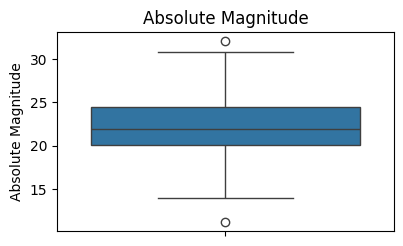

<Figure size 1000x600 with 0 Axes>

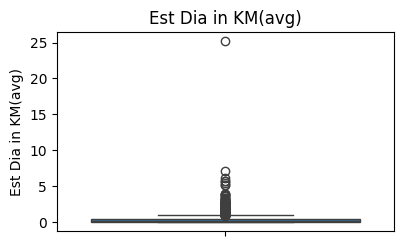

<Figure size 1000x600 with 0 Axes>

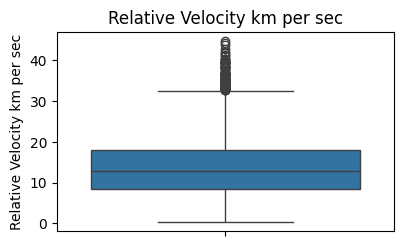

<Figure size 1000x600 with 0 Axes>

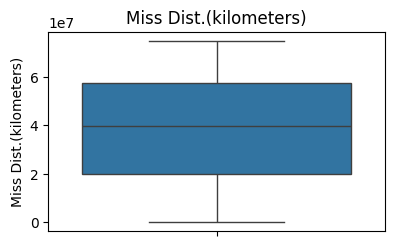

<Figure size 1000x600 with 0 Axes>

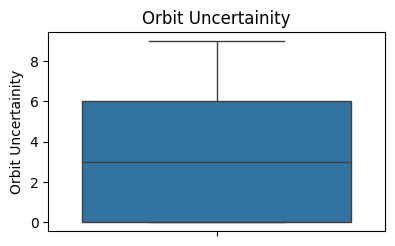

<Figure size 1000x600 with 0 Axes>

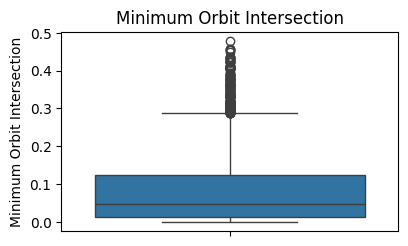

<Figure size 1000x600 with 0 Axes>

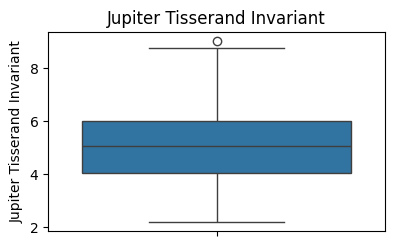

<Figure size 1000x600 with 0 Axes>

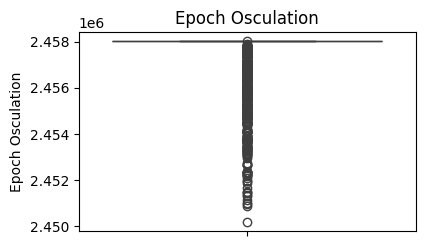

<Figure size 1000x600 with 0 Axes>

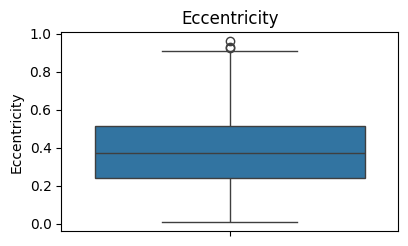

<Figure size 1000x600 with 0 Axes>

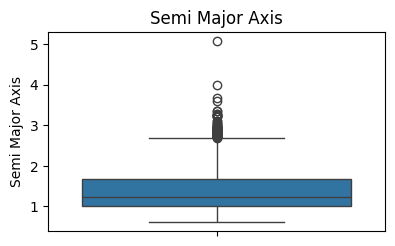

<Figure size 1000x600 with 0 Axes>

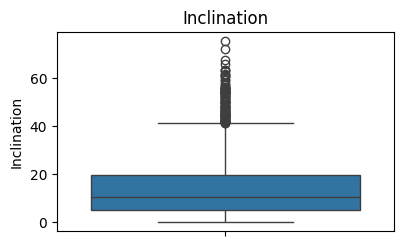

<Figure size 1000x600 with 0 Axes>

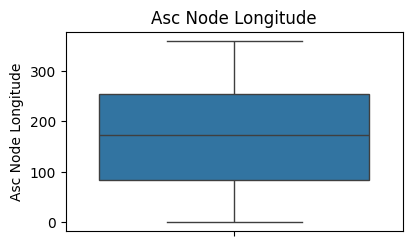

<Figure size 1000x600 with 0 Axes>

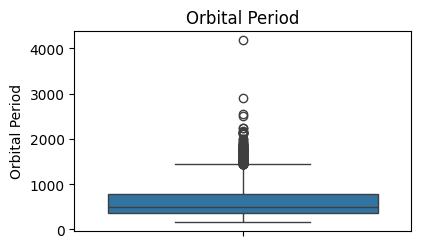

<Figure size 1000x600 with 0 Axes>

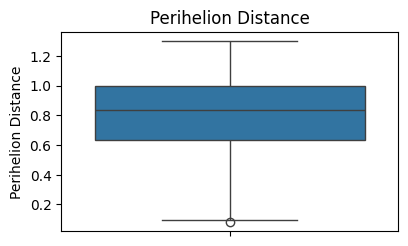

<Figure size 1000x600 with 0 Axes>

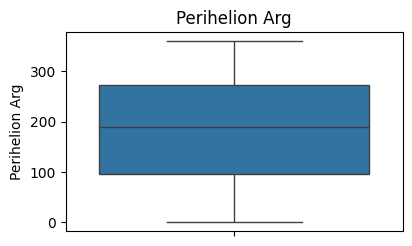

<Figure size 1000x600 with 0 Axes>

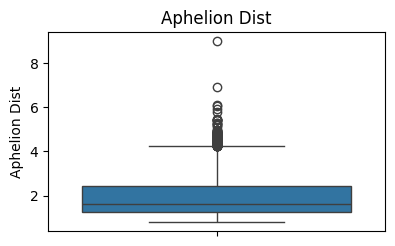

<Figure size 1000x600 with 0 Axes>

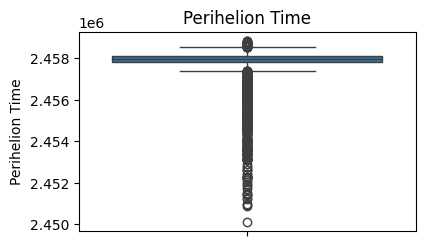

<Figure size 1000x600 with 0 Axes>

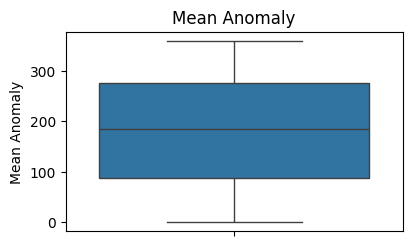

<Figure size 1000x600 with 0 Axes>

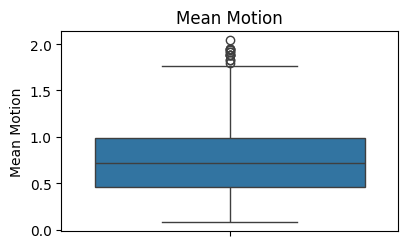

<Figure size 1000x600 with 0 Axes>

In [27]:
column = ['Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec',
    'Miss Dist.(kilometers)', 'Orbit Uncertainity', 'Minimum Orbit Intersection',
    'Jupiter Tisserand Invariant', 'Epoch Osculation', 'Eccentricity',
    'Semi Major Axis', 'Inclination', 'Asc Node Longitude', 'Orbital Period',
    'Perihelion Distance', 'Perihelion Arg', 'Aphelion Dist', 'Perihelion Time',
    'Mean Anomaly', 'Mean Motion']
for i, column in enumerate(column, 1):
    plt.figure(figsize=(20, 15))
    plt.subplot(5, 4, i)  # Adjust the grid size based on the number of columns
    sns.boxplot(df[column])
    plt.title(column)
    plt.xlabel('')
    plt.figure(figsize=(10, 6))

In [28]:

# plt.figure(figsize=(15, 10))
# df[columns].boxplot()
# plt.xticks(rotation=45)
# plt.title('Box Plot of Columns with Potential Outliers')
# plt.ylabel('Value')
# plt.xlabel('Columns')
# plt.show()

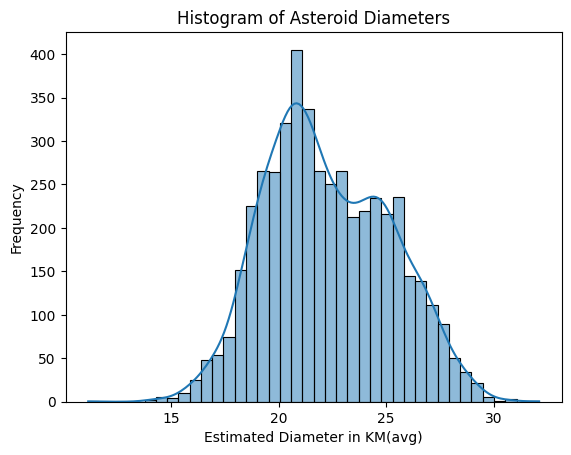

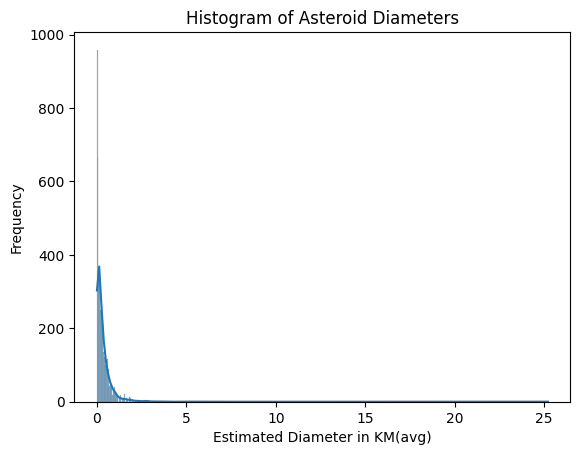

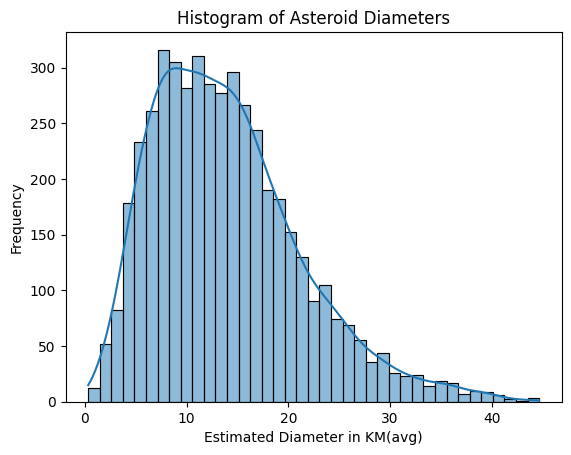

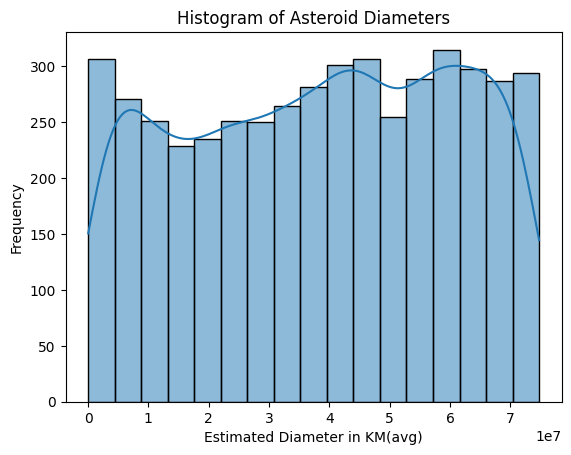

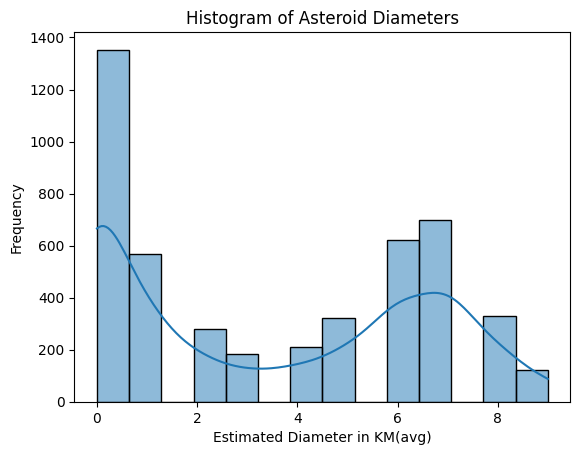

...

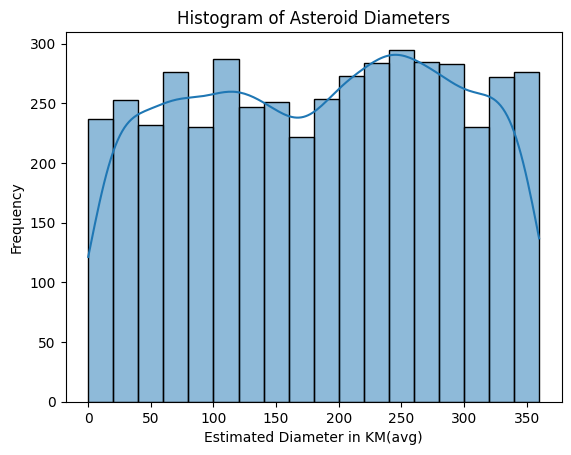

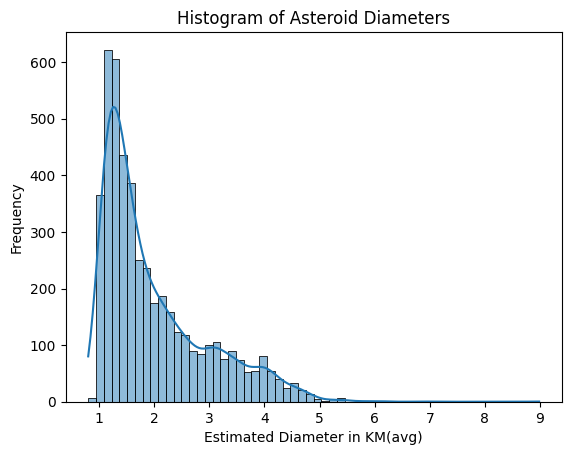

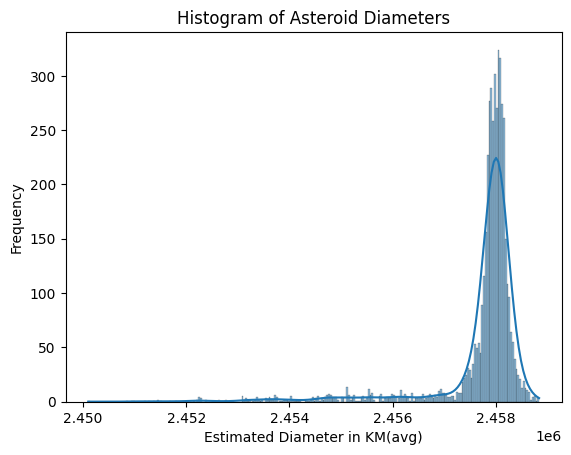

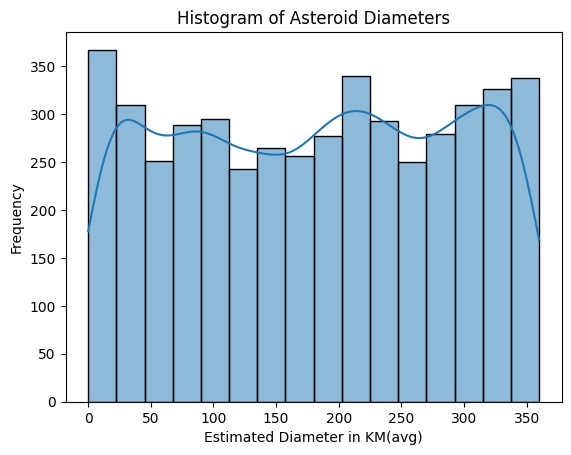

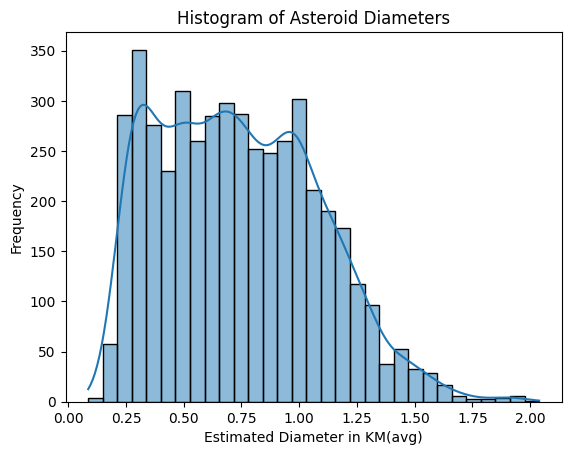

In [29]:
# Histogram
for column in df.columns:
    # plt.figure()
    # df[column].hist(bins=30)
    # plt.title(f'Histogram of {column}')
    # plt.xlabel(column)
    # plt.ylabel('Frequency')
    # plt.show()
    # plt.figure(figsize=(10, 6))
    sns.histplot(df[column], kde=True)
    plt.title('Histogram of Asteroid Diameters')
    plt.xlabel('Estimated Diameter in KM(avg)')
    plt.ylabel('Frequency')
    plt.show()

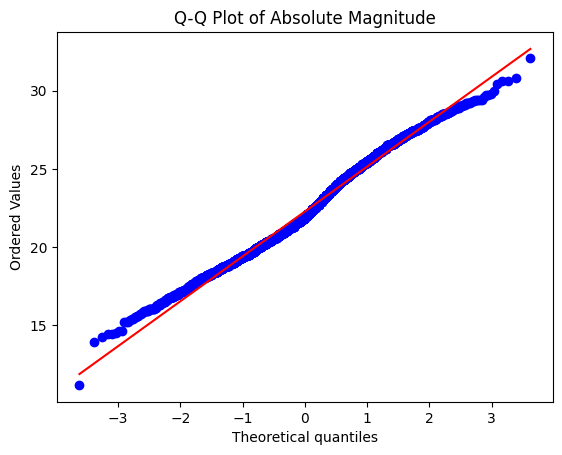

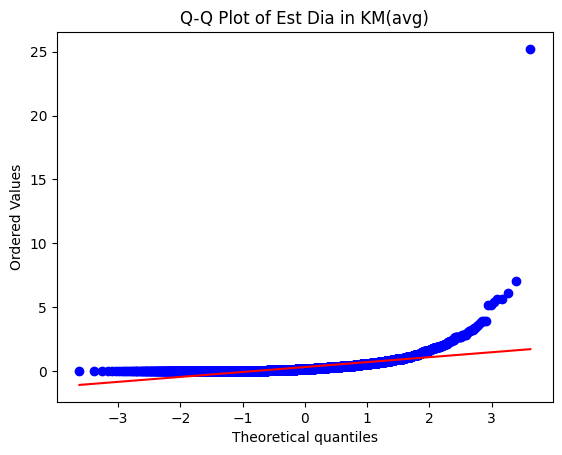

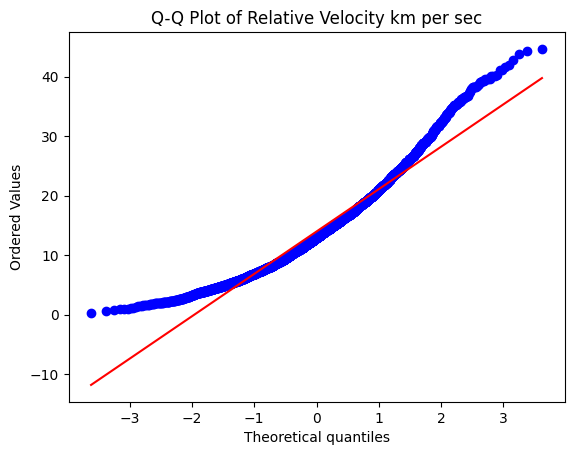

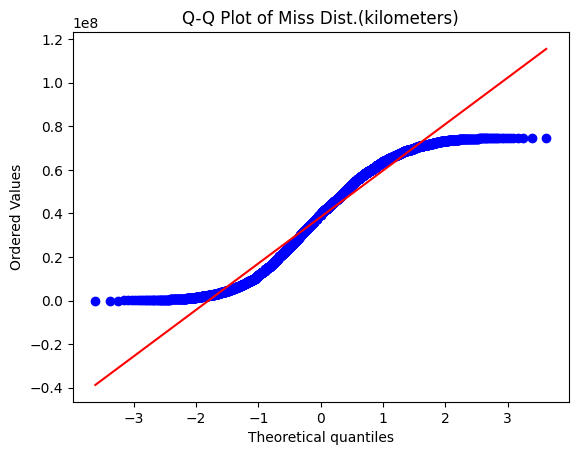

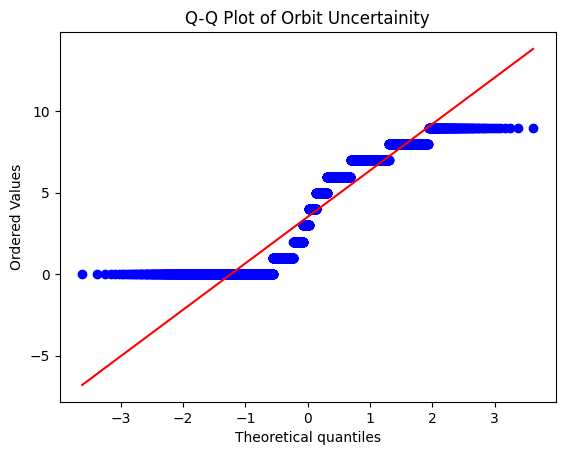

...

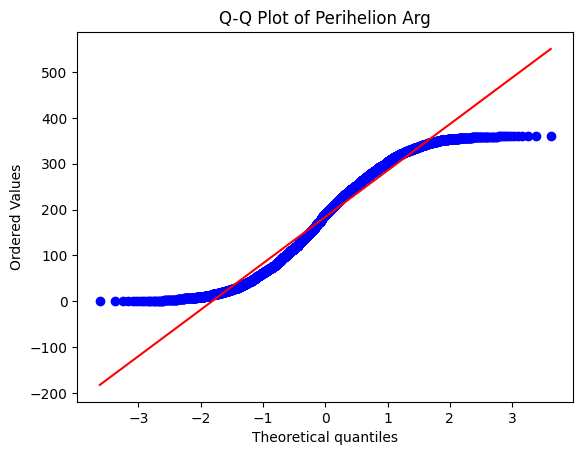

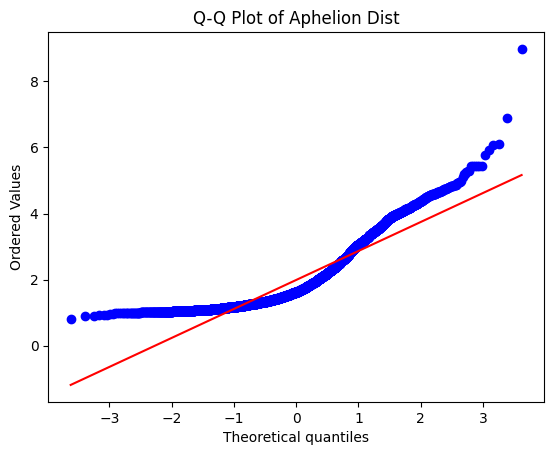

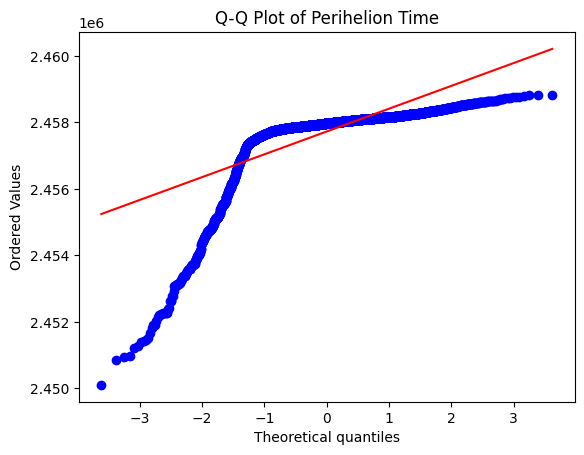

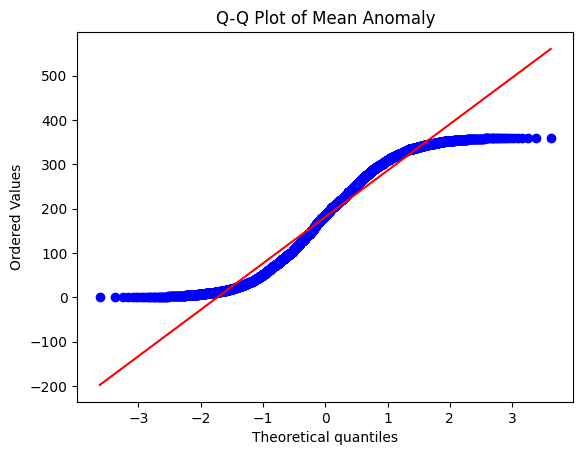

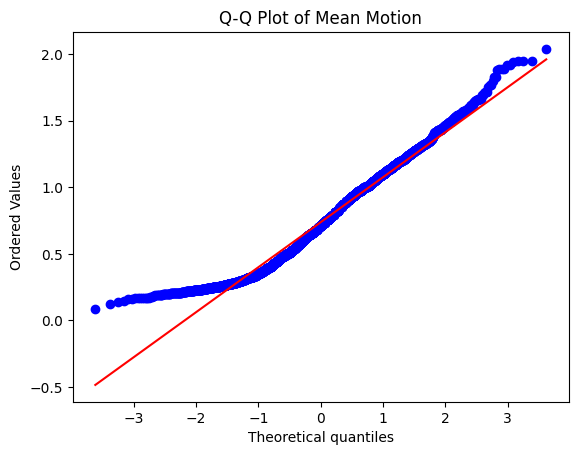

In [30]:
for column in df.columns:
    # plt.figure()
    # stats.probplot(df[column], dist="norm", plot=plt)
    # plt.title(f'Q-Q Plot of {column}')
    # plt.show()
    stats.probplot(df[column], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {column}')
    plt.show()

# model training without handling outliers

In [31]:
# Extract selected features
selected_features=['Neo Reference ID', 'Orbit ID','Orbital Period', 'Perihelion Arg', 'Semi Major Axis', 'Jupiter Tisserand Invariant','Miss Dist.(kilometers)', 'Inclination','Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity','Perihelion Distance', 'Aphelion Dist']
 # = ['Absolute Magnitude', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Perihelion Distance', 'Est Dia in KM(avg)']
X = data[selected_features].copy()
X
y = data['Hazardous']
X
# data['']

,Neo Reference ID,Orbit ID,Orbital Period,Perihelion Arg,Semi Major Axis,Jupiter Tisserand Invariant,Miss Dist.(kilometers),Inclination,Absolute Magnitude,Est Dia in KM(avg),Relative Velocity km per sec,Orbit Uncertainity,Minimum Orbit Intersection,Eccentricity,Perihelion Distance,Aphelion Dist
0,3703080,17,609.599786,57.257470,1.407011,4.634,6.275369e+07,6.025981,21.600,0.205846,6.115834,5,0.025282,0.425549,0.808259,2.005764
1,3723955,21,425.869294,313.091975,1.107776,5.457,5.729815e+07,28.412996,21.300,0.236343,18.113985,3,0.186935,0.351674,0.718200,1.497352
2,2446862,22,643.580228,248.415038,1.458824,4.557,7.622912e+06,4.237961,20.300,0.374578,7.590711,0,0.043058,0.348248,0.950791,1.966857
3,3092506,7,514.082140,18.707701,1.255903,5.093,4.268362e+07,7.905894,27.400,0.014241,11.173875,6,0.005512,0.216578,0.983902,1.527904
4,3514799,25,495.597821,158.263596,1.225615,5.154,6.101082e+07,16.793382,21.600,0.205846,9.840831,1,0.034798,0.210448,0.967687,1.483543
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4682,3759007,4,457.179984,276.395697,1.161429,5.156,6.187511e+06,39.880491,23.900,0.071374,22.154265,8,0.019777,0.361512,0.741558,1.581299
4683,3759295,2,407.185767,42.111064,1.075134,5.742,9.677324e+05,5.360249,28.200,0.009852,3.225150,6,0.006451,0.073200,0.996434,1.153835
4684,3759714,17,690.054279,274.692712,1.528234,4.410,9.126775e+06,4.405467,22.700,0.124035,7.191642,6,0.059972,0.368055,0.965760,2.090708
4685,3759720,6,662.048343,180.346090,1.486600,4.477,3.900908e+07,21.080244,21.800,0.187734,11.352090,5,0.177510,0.202565,1.185467,1.787733


In [32]:
X_train, X_test, y_train, y_test = train_test_split(X , y, test_size=0.2, random_state=42)

from sklearn.preprocessing import StandardScaler

# Initialize the scaler
scaler = StandardScaler()

# Fit and transform the training data
X_train_scaled = scaler.fit_transform(X_train)

# Transform the testing data
X_test_scaled = scaler.transform(X_test)

In [33]:
# Initialize and train the model
model = LogisticRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

C:\Python311\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy: 0.8411513859275054


Classification Report: 
               precision    recall  f1-score   support

           0       0.84      0.99      0.91       791
           1       0.33      0.01      0.03       147

    accuracy                           0.84       938
   macro avg       0.59      0.50      0.47       938
weighted avg       0.76      0.84      0.77       938


Confusion Matrix: 
 [[787   4]
 [145   2]]


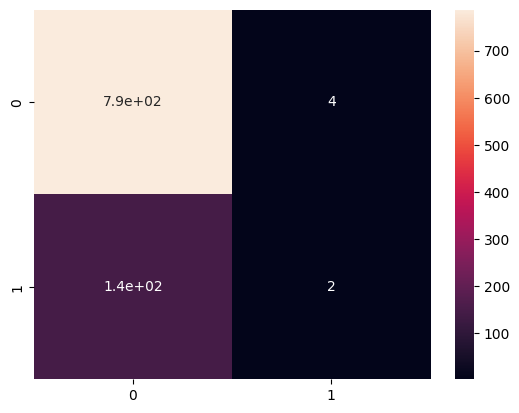

In [34]:
# Evaluate model performance
accuracy = accuracy_score(y_test, predictions)
print("Accuracy:", accuracy)

print("\n\nClassification Report: \n",classification_report(y_test,predictions))

cf=confusion_matrix(y_test,predictions)
print("\nConfusion Matrix: \n",cf)

sns.heatmap(cf,annot=True,)
plt.show()


In [35]:
model_hazardous = RandomForestClassifier(n_estimators=100, random_state=42)
model_hazardous.fit(X_train, y_train)

# Predict and evaluate
y_pred = model_hazardous.predict(X_test)
print(classification_report(y_test, y_pred))
print("Accuracy (Hazardous):", accuracy_score(y_test, y_pred))


              precision    recall  f1-score   support

           0       1.00      1.00      1.00       791
           1       0.99      0.99      0.99       147

    accuracy                           1.00       938
   macro avg       0.99      0.99      0.99       938
weighted avg       1.00      1.00      1.00       938

Accuracy (Hazardous): 0.9957356076759062


In [36]:
# # Hyperparameter tuning for Hazardous
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30]
}

grid_search_hazardous = GridSearchCV(model_hazardous, param_grid, cv=5, scoring='accuracy')
grid_search_hazardous.fit(X_train, y_train)

print("Best parameters (Hazardous):", grid_search_hazardous.best_params_)

Best parameters (Hazardous): {'max_depth': 10, 'n_estimators': 50}


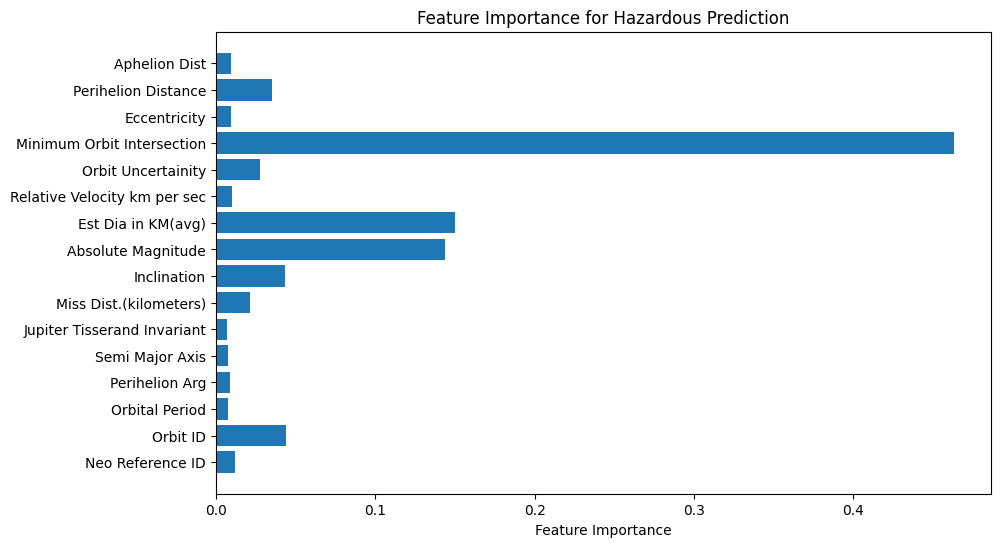

In [37]:
importances_hazardous = model_hazardous.feature_importances_
features = X.columns

plt.figure(figsize=(10, 6))
plt.barh(features, importances_hazardous, align='center')
plt.xlabel('Feature Importance')
plt.title('Feature Importance for Hazardous Prediction')
plt.show()

In [38]:
# Define the number of folds
num_folds = 5

# Initialize KFold cross-validation
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

# Initialize the Random Forest classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Perform k-fold cross-validation
cv_scores = cross_val_score(rf_classifier, X_train, y_train, cv=kf)

# Print the cross-validation scores
print("Cross-validation scores:", cv_scores)

# Calculate and print the mean accuracy
mean_accuracy = cv_scores.mean()
print("Mean accuracy:", mean_accuracy)


Cross-validation scores: [0.996      0.99466667 0.99333333 0.99866667 0.99866489]
Mean accuracy: 0.996266310636404


In [39]:
DTC=DecisionTreeClassifier()
DTC.fit(X_train,y_train)
y_pred=DTC.predict(X_test)

accuracy_score(y_test,y_pred)



0.9957356076759062

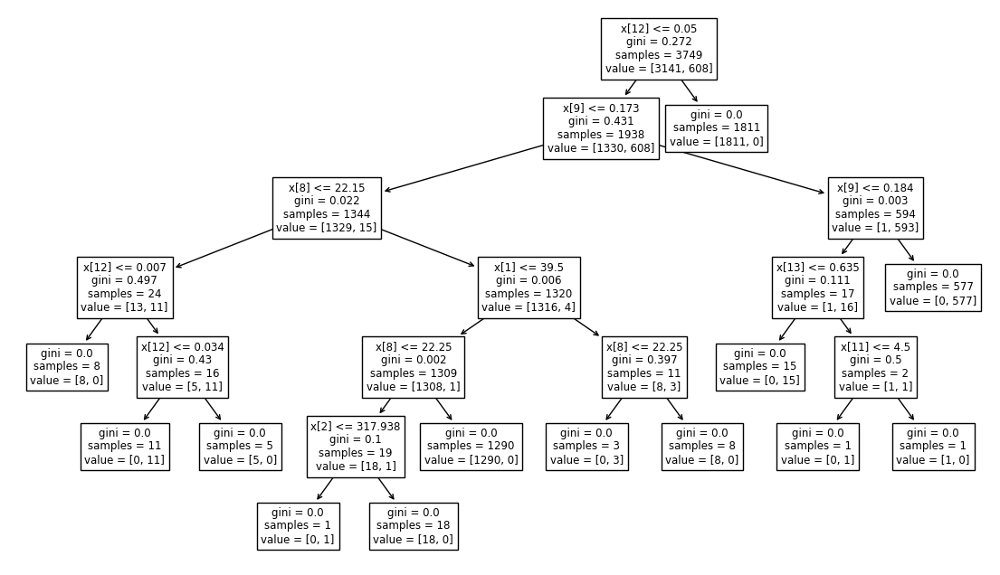

In [40]:
plt.figure(figsize=(14,8))
plot_tree(DTC)
plt.show()

# Handling Outliers

In [75]:
def remove_outliers(df):
    df_no_outliers = df.copy()

    for column_name in df.columns:
        Q1 = df[column_name].quantile(0.25)
        Q3 = df[column_name].quantile(0.75)

        IQR = Q3 - Q1
    
        lower_bound = Q1 - 1.5* IQR
        upper_bound = Q3 + 1.5* IQR
    
        df_no_outliers[column_name] = df_no_outliers[column_name].apply(lambda x: lower_bound if x < lower_bound
                                                                       else upper_bound if x > upper_bound else x)
    return df_no_outliers

df_new = remove_outliers(X)

In [55]:
X = df
y = data['Hazardous']

# Pair Plot

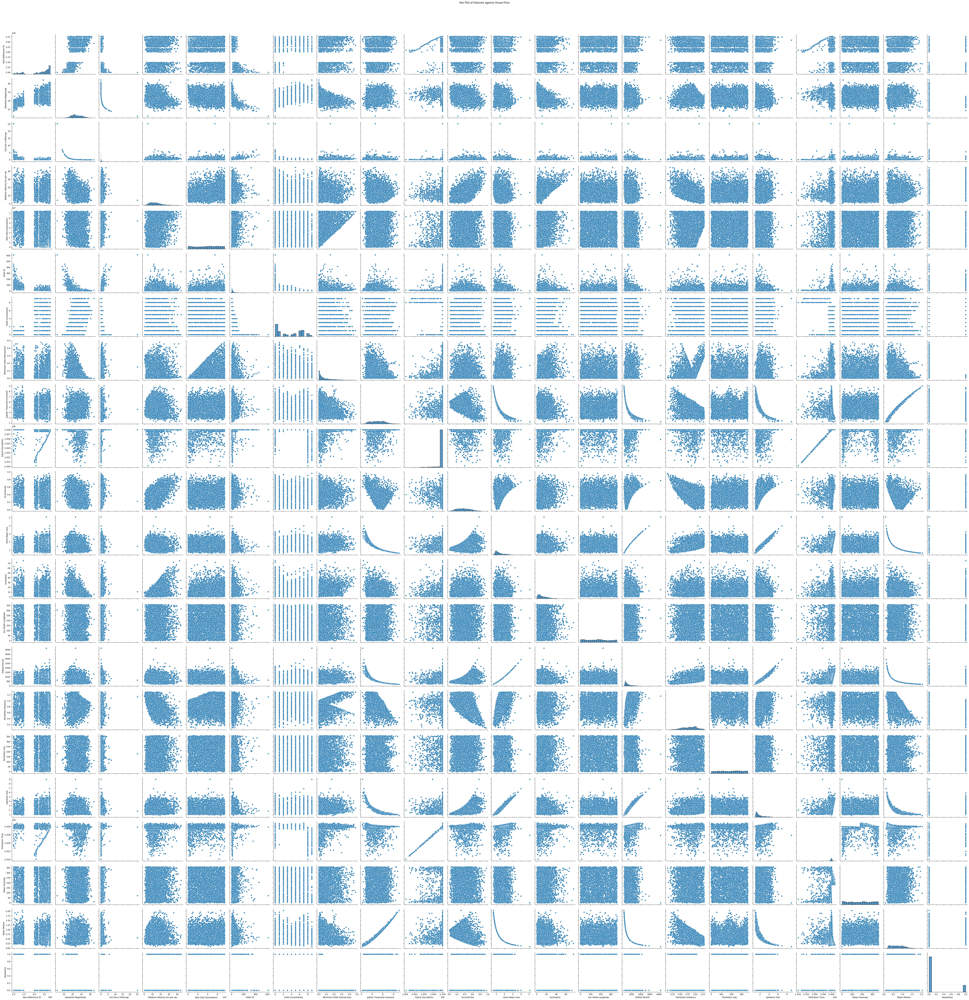

In [56]:
sns.pairplot(data, height=3)
plt.suptitle('Pair Plot of Features against House Price', y=1.02)
plt.show()

# feature selection

# 1. Filter Method

# a. Correlation Matrix with Heatmap

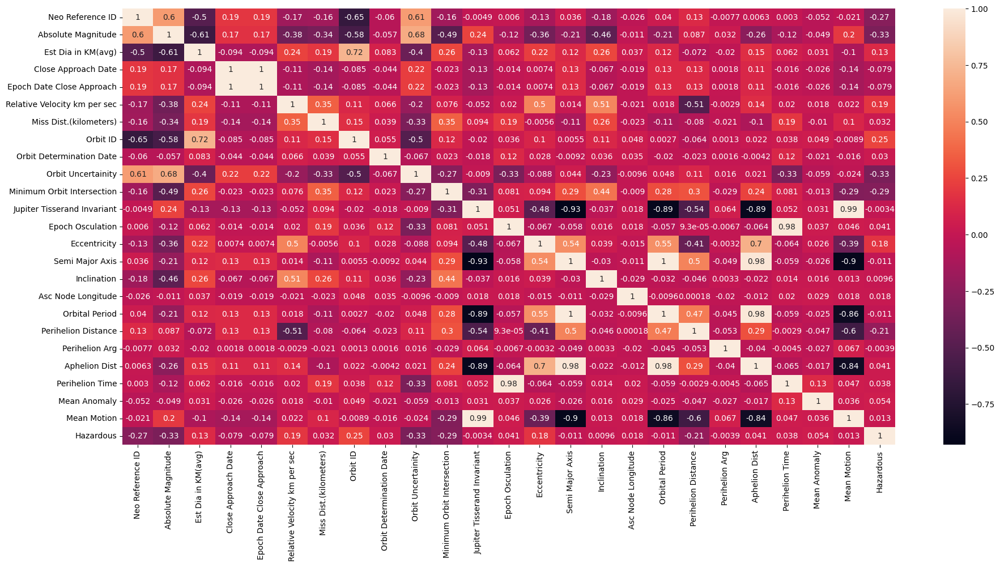

In [57]:
corr_matrix = data.corr()
plt.figure(figsize=(22, 10))
sns.heatmap(corr_matrix , annot = True)
plt.show()

In [72]:
corr_matrix["Hazardous"].abs().sort_values(ascending = False)

Hazardous                       1.000000
Orbit Uncertainity              0.328721
Absolute Magnitude              0.325522
Minimum Orbit Intersection      0.288949
Neo Reference ID                0.269028
Orbit ID                        0.247369
Perihelion Distance             0.207027
Relative Velocity km per sec    0.191970
Eccentricity                    0.183269
Est Dia in KM(avg)              0.132424
Epoch Date Close Approach       0.079020
Close Approach Date             0.079020
Mean Anomaly                    0.054164
Epoch Osculation                0.040940
Aphelion Dist                   0.040800
Perihelion Time                 0.038113
Miss Dist.(kilometers)          0.032407
Orbit Determination Date        0.029974
Asc Node Longitude              0.017536
Mean Motion                     0.013028
Orbital Period                  0.011168
Semi Major Axis                 0.010770
Inclination                     0.009607
Perihelion Arg                  0.003865
Jupiter Tisseran

In [58]:
correlation_threshold = 0.1  # Adjust threshold as needed
correlated_features = corr_matrix.index[abs(corr_matrix['Hazardous']) > correlation_threshold].tolist()

print("Correlated features:", correlated_features)

Correlated features: ['Neo Reference ID', 'Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec', 'Orbit ID', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity', 'Perihelion Distance', 'Hazardous']


# b. Chi-Squared Test

used for categorical target variables and is suitable for feature selection with classification problems.

In [59]:
# chi2_selector = SelectKBest(chi2, k=10)  # Select top 10 features
# X_kbest = chi2_selector.fit_transform(X, y)

# selected_features = X.columns[chi2_selector.get_support()]
# print("Selected features using Chi-Squared Test:", selected_features)

# 2. Wrapper Methods

# a. Recursive Feature Elimination (RFE) 

In [60]:
model = RandomForestClassifier(random_state=42)

rfe = RFE(estimator=model, n_features_to_select=10)  
rfe = rfe.fit(X, y)

selected_features_rfe = X.columns[rfe.support_]
print("Selected features using RFE:", selected_features_rfe)

Selected features using RFE: Index(['Absolute Magnitude', 'Est Dia in KM(avg)',
       'Relative Velocity km per sec', 'Miss Dist.(kilometers)',
       'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity',
       'Inclination', 'Perihelion Distance', 'Aphelion Dist'],
      dtype='object')


# 3. Dimensionality Reduction

a. Principal Component Analysis (PCA)  
PCA is a technique that transforms the data into a lower-dimensional space.

Explained variance by each component: [0.31375826 0.1957676  0.1010307  0.07458819 0.05649847 0.05527402
 0.05282855 0.04482521 0.03367824 0.02882897]


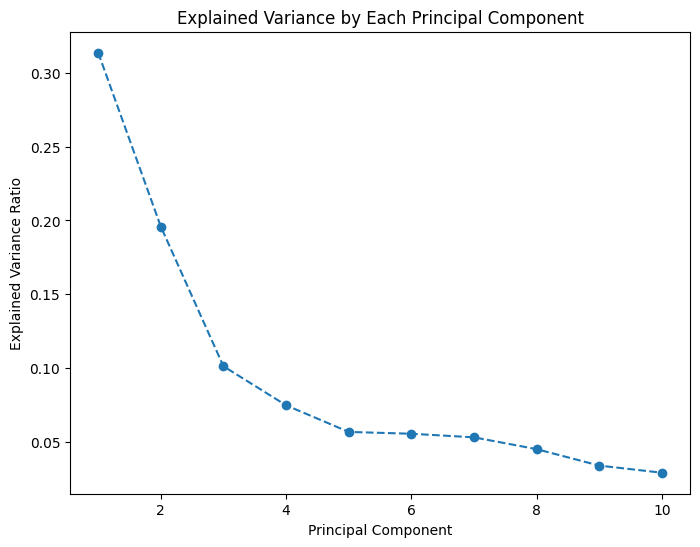

In [61]:
from sklearn.decomposition import PCA

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply PCA
pca = PCA(n_components=10)  # Choose number of components to keep
X_pca = pca.fit_transform(X_scaled)

# Get explained variance ratio
explained_variance = pca.explained_variance_ratio_
print("Explained variance by each component:", explained_variance)

# Visualize explained variance
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o', linestyle='--')
plt.title('Explained Variance by Each Principal Component')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.show()


In [62]:
# Apply SelectKBest with Mutual Information for Regression
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

mi_selector = SelectKBest(mutual_info_regression, k=10)
X_train_mi = mi_selector.fit_transform(X_train, y_train)
X_test_mi = mi_selector.transform(X_test)

# Get the selected feature names
selected_features_mi = X_train.columns[mi_selector.get_support()]
print("Selected features based on Mutual Information for Regression:", selected_features_mi)


Selected features based on Mutual Information for Regression: Index(['Absolute Magnitude', 'Est Dia in KM(avg)',
       'Minimum Orbit Intersection', 'Jupiter Tisserand Invariant',
       'Semi Major Axis', 'Orbital Period', 'Perihelion Distance',
       'Perihelion Arg', 'Aphelion Dist', 'Mean Motion'],
      dtype='object')


In [63]:
# Assuming you have stored the selected features from each method in separate variables

# Create a DataFrame to store the selected features from each method
selected_features_df = {
    'Method 1': ['Neo Reference ID', 'Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec', 'Orbit ID', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity', 'Perihelion Distance'],
    'Method 2': ['Absolute Magnitude', 'Est Dia in KM(avg)',
       'Relative Velocity km per sec', 'Miss Dist.(kilometers)',
       'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity',
       'Inclination', 'Perihelion Distance', 'Aphelion Dist'],
    'Method 3':['Absolute Magnitude', 'Est Dia in KM(avg)', 'Orbit Uncertainity',
       'Minimum Orbit Intersection', 'Jupiter Tisserand Invariant',
       'Semi Major Axis', 'Orbital Period', 'Perihelion Distance',
       'Perihelion Arg', 'Aphelion Dist'],
    # Add more columns for additional methods if needed
}

# Display the DataFrame to compare selected features
print("Selected Features from Different Methods:")
print(selected_features_df)

# Check for common features selected by multiple methods
common_features = set(selected_features_df['Method 1']).intersection(selected_features_df['Method 2'], selected_features_df['Method 3'])
print("\nCommon Features Selected by Multiple Methods:")
print(common_features)

# Check for features unique to each method
unique_features_method1 = set(selected_features_df['Method 1']).difference(selected_features_df['Method 2'], selected_features_df['Method 3'])
unique_features_method2 = set(selected_features_df['Method 2']).difference(selected_features_df['Method 1'], selected_features_df['Method 3'])
unique_features_method3 = set(selected_features_df['Method 3']).difference(selected_features_df['Method 1'], selected_features_df['Method 2'])
print("\nUnique Features Selected by Each Method:")
print("Method 1:", unique_features_method1)
print("Method 2:", unique_features_method2)
print("Method 3:", unique_features_method3)


Selected Features from Different Methods:
{'Method 1': ['Neo Reference ID', 'Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec', 'Orbit ID', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity', 'Perihelion Distance'], 'Method 2': ['Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec', 'Miss Dist.(kilometers)', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity', 'Inclination', 'Perihelion Distance', 'Aphelion Dist'], 'Method 3': ['Absolute Magnitude', 'Est Dia in KM(avg)', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Jupiter Tisserand Invariant', 'Semi Major Axis', 'Orbital Period', 'Perihelion Distance', 'Perihelion Arg', 'Aphelion Dist']}

Common Features Selected by Multiple Methods:
{'Orbit Uncertainity', 'Est Dia in KM(avg)', 'Perihelion Distance', 'Minimum Orbit Intersection', 'Absolute Magnitude'}

Unique Features Selected by Each Method:
Method 1: {'Orbit ID', 'Neo Reference ID'}
Method 2: {'Incli

# further for modeling

In [64]:
# Extract selected features
selected_features=['Neo Reference ID', 'Orbit ID','Orbital Period', 'Perihelion Arg', 'Semi Major Axis', 'Jupiter Tisserand Invariant','Miss Dist.(kilometers)', 'Inclination','Absolute Magnitude', 'Est Dia in KM(avg)', 'Relative Velocity km per sec', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Eccentricity','Perihelion Distance', 'Aphelion Dist']
 # = ['Absolute Magnitude', 'Orbit Uncertainity', 'Minimum Orbit Intersection', 'Perihelion Distance', 'Est Dia in KM(avg)']
X_new = data[selected_features].copy()
X
y_new = data['Hazardous']
X

,Absolute Magnitude,Est Dia in KM(avg),Relative Velocity km per sec,Miss Dist.(kilometers),Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion
0,21.600,0.205846,6.115834,6.275369e+07,5,0.025282,4.634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2458161.642,264.837533,0.590551
1,21.300,0.236343,18.113985,5.729815e+07,3,0.186935,5.457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2457794.969,173.741112,0.845330
2,20.300,0.374578,7.590711,7.622912e+06,0,0.043058,4.557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2458120.468,292.893654,0.559371
3,27.400,0.014241,11.173875,4.268362e+07,6,0.005512,5.093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2457902.337,68.741007,0.700277
4,21.600,0.205846,9.840831,6.101082e+07,1,0.034798,5.154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2457814.455,135.142133,0.726395
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4682,23.900,0.071374,22.154265,6.187511e+06,8,0.019777,5.156,2458000.5,0.361512,1.161429,39.880491,164.183305,457.179984,0.741558,276.395697,1.581299,2457708.228,304.306024,0.787436
4683,28.200,0.009852,3.225150,9.677324e+05,6,0.006451,5.742,2458000.5,0.073200,1.075134,5.360249,345.225230,407.185767,0.996434,42.111064,1.153835,2458087.617,282.978786,0.884117
4684,22.700,0.124035,7.191642,9.126775e+06,6,0.059972,4.410,2458000.5,0.368055,1.528234,4.405467,37.026468,690.054279,0.965760,274.692712,2.090708,2458300.480,203.501147,0.521698
4685,21.800,0.187734,11.352090,3.900908e+07,5,0.177510,4.477,2458000.5,0.202565,1.486600,21.080244,163.802909,662.048343,1.185467,180.346090,1.787733,2458288.261,203.524965,0.543767


In [65]:
X_train, X_test, y_train, y_test = train_test_split(X_new , y_new, test_size=0.2, random_state=42)

from sklearn.preprocessing import StandardScaler

# Initialize the scaler
scaler = StandardScaler()

# Fit and transform the training data
X_train_scaled = scaler.fit_transform(X_train)

# Transform the testing data
X_test_scaled = scaler.transform(X_test)

In [66]:
# Initialize the scaler
scaler = StandardScaler()

# Fit and transform the training data
X_train_scaled = scaler.fit_transform(X_train)

# Transform the testing data
X_test_scaled = scaler.transform(X_test)



Accuracy: 0.8411513859275054


Classification Report: 
               precision    recall  f1-score   support

           0       0.84      0.99      0.91       791
           1       0.33      0.01      0.03       147

    accuracy                           0.84       938
   macro avg       0.59      0.50      0.47       938
weighted avg       0.76      0.84      0.77       938


Confusion Matrix: 
 [[787   4]
 [145   2]]


C:\Python311\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


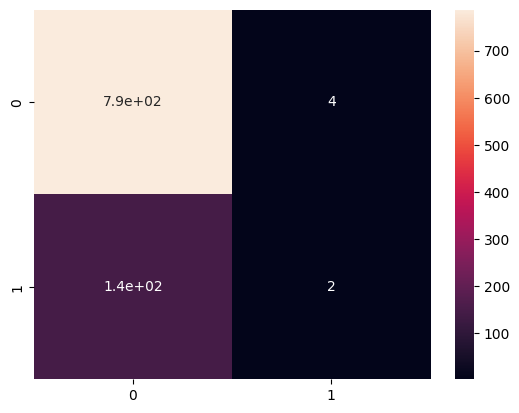

In [67]:
# Initialize and train the model
model = LogisticRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
predictions = model.predict(X_test)

# Evaluate model performance
accuracy = accuracy_score(y_test, predictions)
print("Accuracy:", accuracy)

# print("Acc: ",accuracy_score(y_test,predictions))

print("\n\nClassification Report: \n",classification_report(y_test,predictions))

cf=confusion_matrix(y_test,predictions)
print("\nConfusion Matrix: \n",cf)

sns.heatmap(cf,annot=True,)
plt.show()



In [68]:
model_hazardous = RandomForestClassifier(n_estimators=100, random_state=42)
model_hazardous.fit(X_train, y_train)

# Predict and evaluate
y_pred = model_hazardous.predict(X_test)
print(classification_report(y_test, y_pred))
print("Accuracy (Hazardous):", accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       791
           1       0.99      0.99      0.99       147

    accuracy                           1.00       938
   macro avg       0.99      0.99      0.99       938
weighted avg       1.00      1.00      1.00       938

Accuracy (Hazardous): 0.9957356076759062


In [69]:
# # Hyperparameter tuning for Hazardous
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30]
}

grid_search_hazardous = GridSearchCV(model_hazardous, param_grid, cv=5, scoring='accuracy')
grid_search_hazardous.fit(X_train, y_train)

print("Best parameters (Hazardous):", grid_search_hazardous.best_params_)

# # Hyperparameter tuning for type prediction
# grid_search_type = GridSearchCV(model_hazardous, param_grid, cv=5, scoring='accuracy')
# grid_search_type.fit(X_train, y_train)

# print("Best parameters (Type):", grid_search_type.best_params_)

Best parameters (Hazardous): {'max_depth': 10, 'n_estimators': 50}


In [1]:
# importances_hazardous = model_hazardous.feature_importances_
# features = X.columns

# plt.figure(figsize=(10, 6))
# plt.barh(features, importances_hazardous, align='center')
# plt.xlabel('Feature Importance')
# plt.title('Feature Importance for Hazardous Prediction')
# plt.show()

In [ ]:
from sklearn.model_selection import cross_val_score, KFold

# Define the number of folds
num_folds = 5

# Initialize KFold cross-validation
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

# Initialize the Random Forest classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Perform k-fold cross-validation
cv_scores = cross_val_score(rf_classifier, X_train, y_train, cv=kf)

# Print the cross-validation scores
print("Cross-validation scores:", cv_scores)

# Calculate and print the mean accuracy
mean_accuracy = cv_scores.mean()
print("Mean accuracy:", mean_accuracy)


In [ ]:
DTC=DecisionTreeClassifier()
DTC.fit(X_train,y_train)
y_pred=DTC.predict(X_test)

accuracy_score(y_test,y_pred)

plt.figure(figsize=(14,8))
plot_tree(DTC)
plt.show()

In [ ]:
plt.figure(figsize=(14,8))
plot_tree(DTC)
plt.show()

In [ ]:
train_score , test_score = list(), list()
values = [i for i in range(1,21)]
for i in values:
    dtc = DecisionTreeClassifier(max_depth=i)
    dtc.fit(X_train, y_train)
    
    train_pred = dtc.predict(X_train)
    train_acc = accuracy_score(y_train, train_pred)
    
    test_pred = dtc.predict(X_test)
    test_acc = accuracy_score(y_test , test_pred)
    
    train_score.append(train_acc)
    test_score.append(test_acc)

    print('>%d , train: %.3f , tets: %.3f' %(i , train_acc, test_acc))
    
    

In [ ]:
plt.plot(values, train_score , '-o' , label = 'Train')
plt.plot(values, test_score , '-o' , label = 'Test')
plt.legend()
plt.show()


In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
param_grid = {'criterion': ['gini' , 'entropy'], 
              'max_depth':[2,3,6,10,20],
               'min_samples_split': [5,10,20,50,100]}

cv = GridSearchCV(DecisionTreeClassifier() , param_grid , cv = 3 , n_jobs=-1 , scoring='accuracy')
cv.fit(X_train , y_train)

In [ ]:
best_model = cv.best_estimator_

In [ ]:
print(accuracy_score(y_train , best_model.predict(X_train)))
print(accuracy_score(y_test ,best_model.predict(X_test)))


# to get info of ASTEROID using  neo_reference_id

In [ ]:
# import requests
# import json

# # Define the base URL for the JPL Small-Body Database API
# base_url = "https://ssd.jpl.nasa.gov/api/sbdb.api"

# # Neo Reference ID of the asteroid you want to query
# neo_reference_id = "3703080"

# # Query parameters
# params = {
#     'sstr': neo_reference_id,  # Neo Reference ID of the asteroid
#     'full_precision': 'true'    # Include full precision in results
# }

# try:
#     # Make the request to the API
#     response = requests.get(base_url, params=params)
    
#     # Check if the request was successful
#     response.raise_for_status()
    
#     # Parse the JSON response
#     data = response.json()
    
#     # Extract relevant information
#     name = data['object']['fullname']
#     orbit_class = data['object']['orbit_class']
#     diameter = data['object']['estimated_diameter']['kilometers']

#     # Print the information
#     print("Name:", name)
#     print("Orbit Class:", orbit_class)
#     print("Estimated Diameter (km):", diameter)

# except requests.HTTPError as e:
#     print("HTTP Error:", e)
# except json.JSONDecodeError as e:
#     print("JSON Decode Error:", e)
# except Exception as e:
#     print("Error:", e)
